In [7]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import Image

# Display image

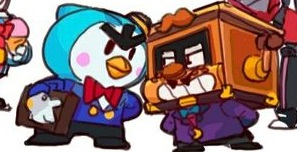

In [8]:
Image(filename="img.jpeg")

# Reading images

optional args:
* `cv2.IMREAD_GRAYSCALE` or `0` : Loads image in grayscale
* `cv2.IMREAD_COLOR` or `1` : Loads a color image. Any transparency will be neglected. (default)
* `cv2.IMREAD_UNCHANGED` or `-1`: Loads image as such including alpha channel

In [14]:
# Returns numpy 2d array
cb_img = cv2.imread("img.jpeg", 0)
print(cb_img)

[[220 122  78 ...  41  41  75]
 [155  73  69 ...  48  29  70]
 [ 78  71  95 ...  66  21  64]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]


* Pixel values are in the range 0 to 255 because the image is represented by unsigned 8 bit integer

# Display Image attributes

In [17]:
print("Size:", cb_img.shape)
print("Data type:", cb_img.dtype)

Size: (152, 297)
Data type: uint8


# Display with matplotlib

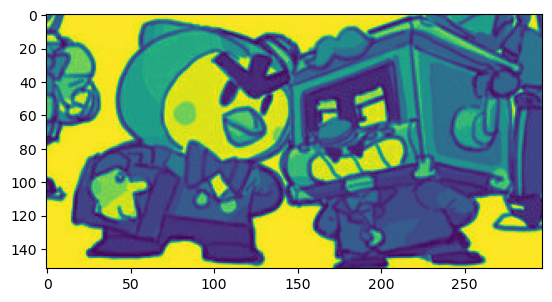

In [23]:
# argument: numpy array
plt.imshow(cb_img)

* It is actually a plot, and it is not the real size of the image
* The color has changed because it uses color maps to represent images, here it uses some other instead of the grayscale or original map
* You have to manually set the color map

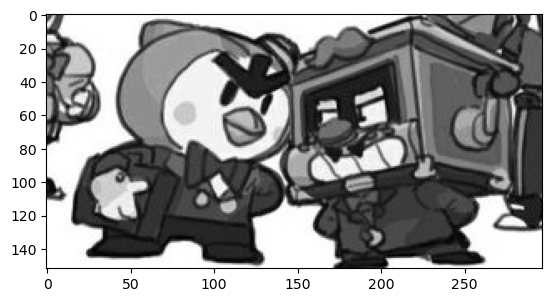

In [26]:
plt.imshow(cb_img, cmap='gray')

In [37]:
img = cv2.imread("img.jpeg", 1) # the same image

In [39]:
print("Shape:", img.shape)
print("Datatype:", img.dtype)

Shape: (152, 297, 3)
Datatype: uint8


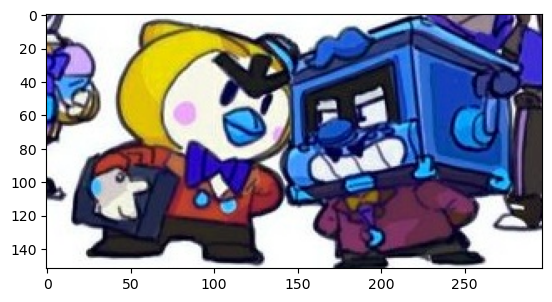

In [41]:
plt.imshow(img)

* The color changes because OpenCV uses a different format to store the images
* For RGB images, it uses BGR channel ordering
* So matplotlib expects it to be RGB, but we gave it BGR
* So we have to swap the order of channels

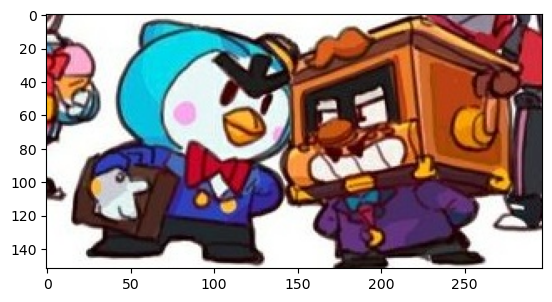

In [44]:
img_channel_reversed = img[:,:,::-1]
plt.imshow(img_channel_reversed)

# Splitting and merging color channels

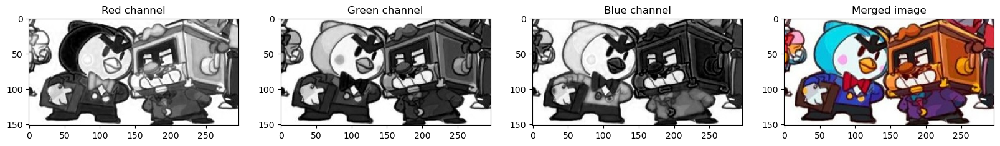

In [63]:
img = cv2.imread("img.jpeg", cv2.IMREAD_COLOR)
b, g, r = cv2.split(img)

plt.figure(figsize=[20,5])

plt.subplot(141);
plt.imshow(r, cmap="gray");
plt.title("Red channel");

plt.subplot(142);
plt.imshow(g, cmap="gray");
plt.title("Green channel");

plt.subplot(143);
plt.imshow(b, cmap="gray");
plt.title("Blue channel");

img_merged = cv2.merge((b,g,r))[:,:,::-1]

plt.subplot(144);
plt.imshow(img_merged);
plt.title("Merged image");

* 0 represents black (low intensity) and 255 represents white (high intensity)
* if you look at the penguins' blue skin in the red channel, it is very low(black), means there isn't much red component in that area, that's why it is darker (closer to 0)
* but in the blue and green channels, it more towards white (high intensity), means those two colors dominate in the original image
* Likewise, if you look at the bow tie, it's red in the original image, and in the red channel..its near to white (high intensity) means the red channel value is responsible to give the color in that area of the original image

# Converting into different color spaces

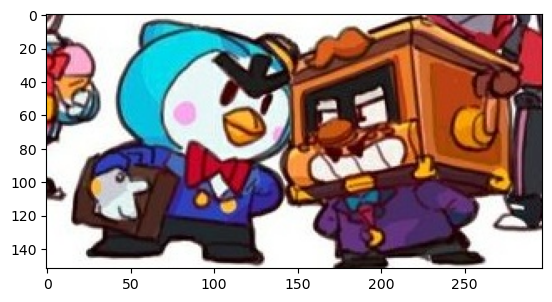

In [69]:
# Change BGR to RGB
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img_rgb)

# Changing to HSV color space

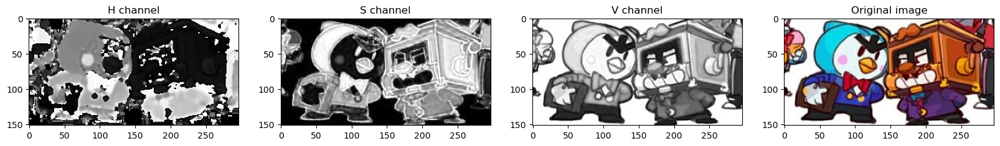

In [72]:
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

h,s,v = cv2.split(img_hsv)

plt.figure(figsize=[20,5])

plt.subplot(141);
plt.imshow(h, cmap="gray");
plt.title("H channel");

plt.subplot(142);
plt.imshow(s, cmap="gray");
plt.title("S channel");

plt.subplot(143);
plt.imshow(v, cmap="gray");
plt.title("V channel");

plt.subplot(144);
plt.imshow(img_rgb);
plt.title("Original image");

* HSV stands for Hue Saturation and Value
* Hue represents the actual color of the image
* Saturation represents how intense or pure that color is
* Value controls the brightness or lightness of that color

# Modifying individual channels

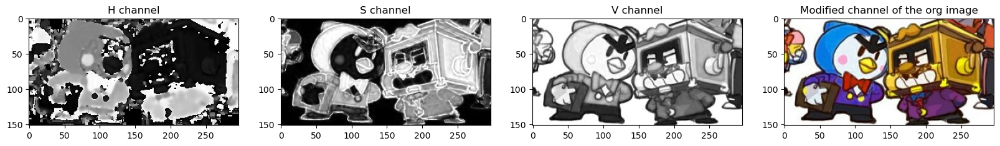

In [78]:
h_new = h + 10
img_merged = cv2.merge((h_new, s, v))
img_rgb = cv2.cvtColor(img_merged, cv2.COLOR_HSV2RGB)

plt.figure(figsize=[20,5])

plt.subplot(141);
plt.imshow(h_new, cmap="gray");
plt.title("H channel");

plt.subplot(142);
plt.imshow(s, cmap="gray");
plt.title("S channel");

plt.subplot(143);
plt.imshow(v, cmap="gray");
plt.title("V channel");

plt.subplot(144);
plt.imshow(img_rgb);
plt.title("Modified channel of the org image");

# Saving images

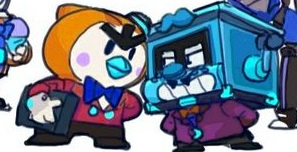

In [83]:
cv2.imwrite("save_img.jpg", img_rgb)
Image(filename="save_img.png")

# Displaying images with opencv in IDEs

```python
img = cv2.imread("image.jpg")

# displays the image for 8 secs
window1 = cv2.namedWindow("w1")
cv2.imshow(window1, img)
cv2.waitKey(8000)
cv2.destroyWindow(window1)

# displays the image forever...untill 'any' key is pressed
window2 = cv2.namedWindow("w2")
cv2.imshow(window2, img)
cv2.waitKey(0)
cv2.destroyWindow(window2)

# displays the image forever, untill 'q' is pressed
window3 = cv2.namedWindow("w3")
Alive = True

while Alive:
    cv2.imshow(window3, img)
    keypress = cv2.waitKey(1)
    if keypress == ord('q'):
        Alive = False

cv2.destroyWindow(window1)
```

# Accessing individual pixels

In [4]:
# Returns numpy 2d array
cb_img = cv2.imread("img.jpeg", 0)
print(cb_img)

[[220 122  78 ...  41  41  75]
 [155  73  69 ...  48  29  70]
 [ 78  71  95 ...  66  21  64]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]


In [9]:
print(cb_img[0,0])
print(cb_img[1,-1])

220
70


# Modifying image pixels

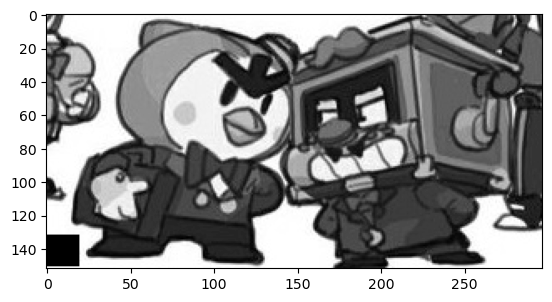

In [14]:
cb_img_copy = cb_img.copy()
cb_img_copy[-20:-1,:20] = 0
plt.imshow(cb_img_copy, cmap="gray")

# Cropping

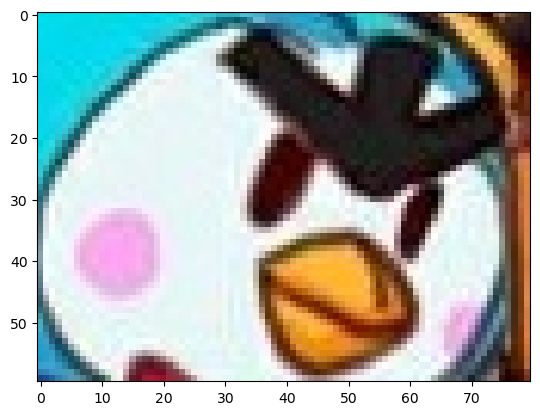

In [23]:
cb_img = cv2.imread("img.jpeg", 1)
cb_img_crop = cb_img[:,:,::-1]
cb_img_crop = cb_img_crop[20:80, 70:150]
plt.imshow(cb_img_crop)

# Resizing

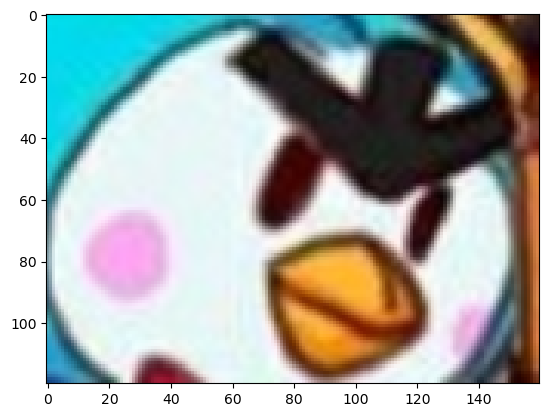

In [26]:
# fx and fy are scale factors along x and y axis
resized = cv2.resize(cb_img_crop, None, fx=2, fy=2)
plt.imshow(resized)

* Notice the image got bigger
* And it is less pixelated, as it uses some default interpolation methods to fill the blank rows and columns
* The default method is `cv2.INTER_LINEAR`

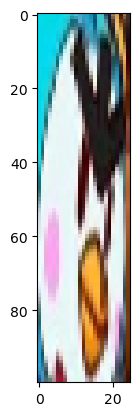

In [31]:
resized = cv2.resize(cb_img_crop, (25,100))
plt.imshow(resized)

# Resizing while maintaing aspect ratio

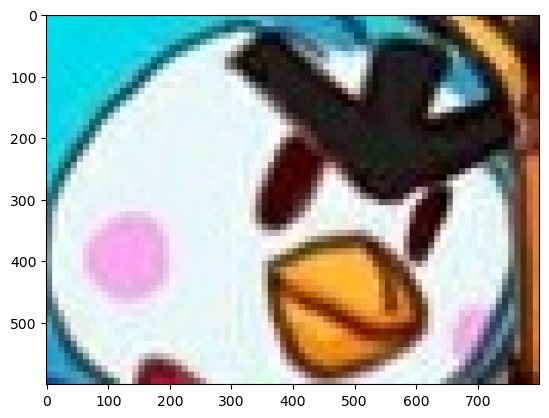

In [38]:
new_width = 800
aspect_ratio = new_width/cb_img_crop.shape[1]
new_height = int(cb_img_crop.shape[0]*aspect_ratio)

resized = cv2.resize(cb_img_crop, (new_width, new_height), interpolation=cv2.INTER_AREA)
plt.imshow(resized)

# flipping image

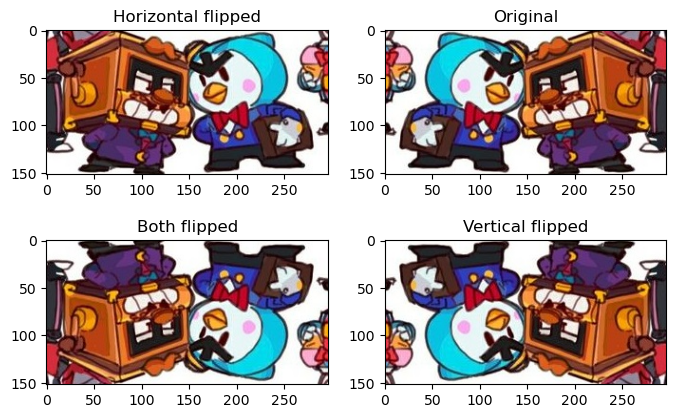

In [57]:
img_flip_hori = cv2.flip(cb_img[:,:,::-1], 1)
img_flip_vert = cv2.flip(cb_img[:,:,::-1], 0)
img_flip_both = cv2.flip(cb_img[:,:,::-1], -1)


plt.figure(figsize=[8,5])

plt.subplot(221);
plt.imshow(img_flip_hori);
plt.title("Horizontal flipped");

plt.subplot(224);
plt.imshow(img_flip_vert);
plt.title("Vertical flipped");

plt.subplot(223);
plt.imshow(img_flip_both);
plt.title("Both flipped");

plt.subplot(222);
plt.imshow(cb_img[:,:,::-1]);
plt.title("Original");

# Image Annotation

Below are some common annotations to images:
* Draw lines
* Draw circles
* Draw rectangles
* Add text

# Draw a line

```python
cv2.line(img, pt1, pt2, color, thickness, lineType, shift)
```

* `cv2.LINE_AA` stands for Anti aliased

# Draw a circle

```python
cv2.circle(img, center, radius, color, thickness, lineType, shift)
```

* when thickness is negative value, it fills the circle

# Draw rectangle

# Adding text

```python
cv2.putText(img, text, org, fontFace, fontScale, color, thickness, lineType, bottomleftorigin)
```

org = bottom left corner of the text string in that image

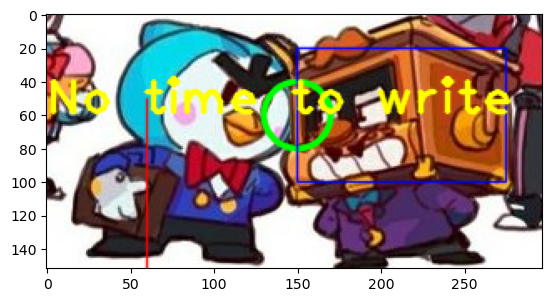

In [188]:
image_line = image.copy()
#(x,y) point notation
cv2.line(image_line, (60,50), (60, 200), (0, 0, 255), lineType=cv2.LINE_AA)
cv2.circle(image_line, (150, 60), 20, (0, 255, 0), thickness=2, lineType=cv2.LINE_AA)

# syntax same as line
# pt1 = top left coordinate
# pt2 = bottom right coordinate
cv2.rectangle(image_line, (150,20), (275,100), (255, 0, 0), lineType=cv2.LINE_AA)

text = "No time to write long texts"
fontScale = 2
fontFace = cv2.FONT_HERSHEY_PLAIN
fontColor = (0,255,255)
fontThickness = 2
cv2.putText(image_line, text, (0,60), fontFace, fontScale, fontColor, fontThickness, cv2.LINE_AA)
plt.imshow(image_line[:,:,::-1])

* `cv2.LINE_16` is not supported by **cv2.line**

# Accessing the camera

```python
import cv2
import sys

s = 0  # camera device index number
if len(sys.argv) > 1:  # check some other index number is provided via commandline
    s = sys.argv[1]

source = cv2.VideoCapture(s)

win_name = 'Camera Preview'
cv2.namedWindow(win_name, cv2.WINDOW_NORMAL)

while cv2.waitKey(1) != 27: # check if Escape key (27) is pressed or not
    has_frame, frame = source.read()
    if not has_frame:
        break
    cv2.imshow(win_name, frame)

source.release()
cv2.destroyWindow(win_name)
```

# Writing a video

In [194]:
source = "bvs.mp4"
cap = cv2.VideoCapture(source)
if cap.isOpened() == False:
    print("Error opening video stream or file")

In [196]:
ret, frame = cap.read()

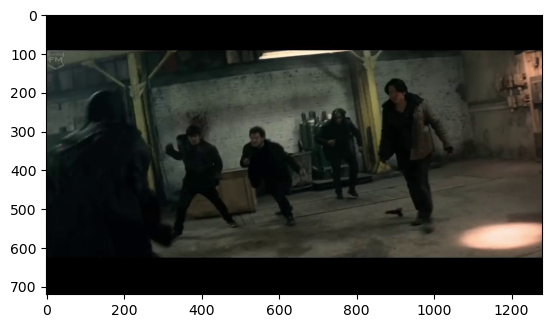

In [198]:
plt.imshow(frame[...,::-1])

In [3]:
from IPython.display import HTML
HTML("""
<video width=512 controls>
  <source src="bvs.mp4" type="video/mp4">
</video>
""")

In [204]:
frame_w = int(cap.get(3))
frame_h = int(cap.get(4))

out_avi = cv2.VideoWriter("bvs.avi", cv2.VideoWriter_fourcc("M", "J", "P", "G"), 10, (frame_w, frame_h))

In [206]:
try:
    while cap.isOpened():
        ret, frame = cap.read()
        if ret:
            out_avi.write(frame)
        else:
            break
except Exception as e:
    print(e)

finally:
    cap.release()
    out_avi.release()

# Image Alignment

* also known as image registeration
* Applications:
  * Used to create panaroma
  * used in medical field to align scans to detect minor changes
  * constructing HDR image from multiple images taken at different exposure

* Translation:
  * Shifting of the pixel coordinates from one location to another
* Euclidean:
  * Rotation
* Affine:
  * Shrear and scale changes (parallels remain parallels)
* Homograph:
  * projection (arbitary quadrilateral)

![alt text](https://learnopencv.com/wp-content/uploads/2023/03/opencv_bootcamp_08_motion-models.jpg "Motion Models")

How to align images:
* We have to identify atleast 4 points that correspond to the same physical location
* 4 is min req. In practice we need more
* By that way we can compute the homograph between two images
* Those 4 points are called corresponding points

!["Homography Example"](https://learnopencv.com/wp-content/uploads/2023/03/opencv_bootcamp_08_homography-example.jpg)

In [218]:
form = cv2.imread("form.jpg", cv2.IMREAD_COLOR)
form = cv2.cvtColor(form, cv2.COLOR_BGR2RGB)
scanned_form = cv2.imread("scanned-form.jpg", cv2.IMREAD_COLOR)
scanned_form = cv2.cvtColor(scanned_form, cv2.COLOR_BGR2RGB)

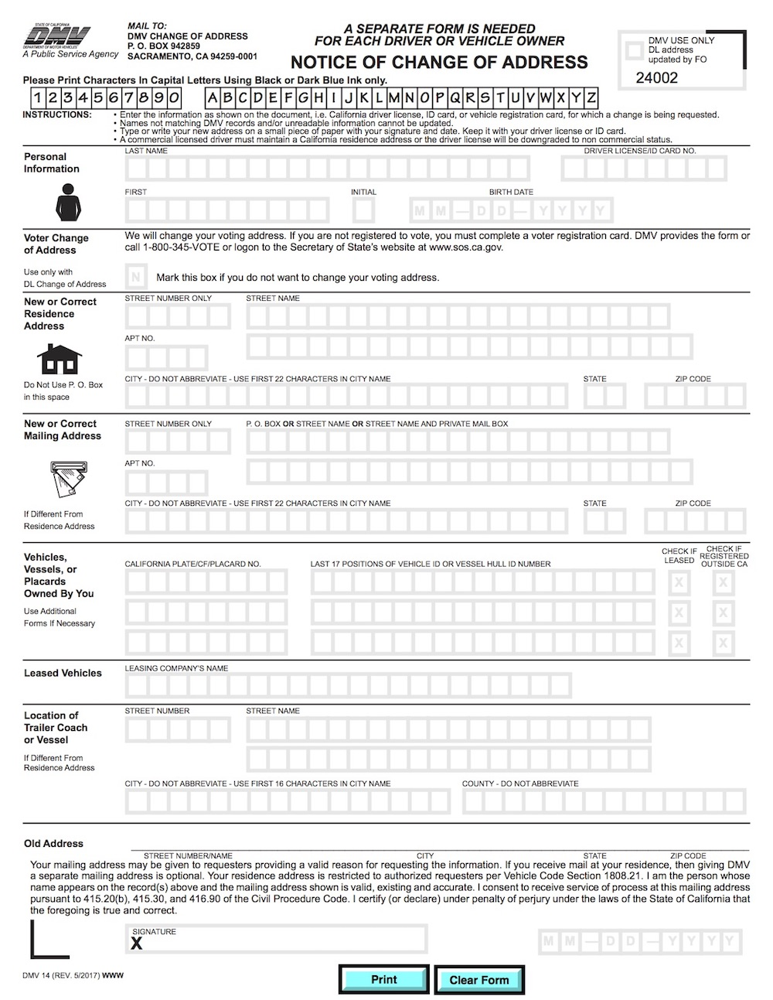

In [222]:
Image(filename="form.jpg")

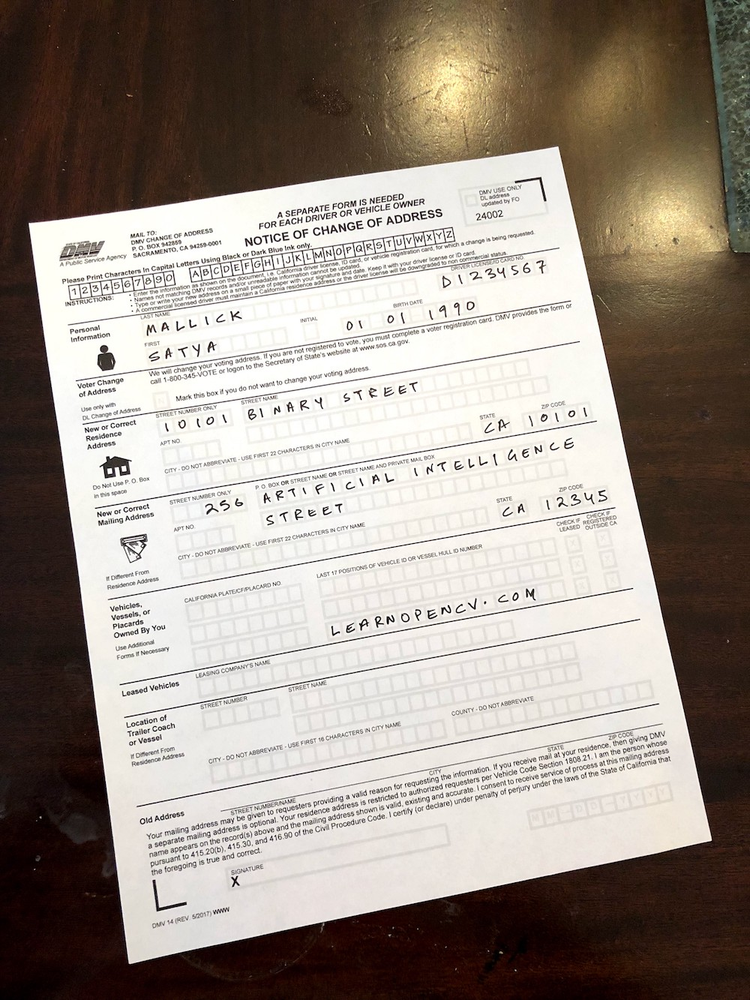

In [224]:
Image(filename="scanned-form.jpg")

### Find some keypoints

ORB is faster than SIFT and SURF

In [314]:
img1_gray = cv2.cvtColor(form, cv2.COLOR_BGR2GRAY)
img2_gray = cv2.cvtColor(scanned_form, cv2.COLOR_BGR2GRAY)

max_features = 500

orb = cv2.ORB_create(max_features)
keypoints1, descriptors1 = orb.detectAndCompute(img1_gray, None)
keypoints2, descriptors2 = orb.detectAndCompute(img2_gray, None)

im1_display = cv2.drawKeypoints(img1_gray, keypoints1, outImage=np.array([]), color=(255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im2_display = cv2.drawKeypoints(img2_gray, keypoints2, outImage=np.array([]), color=(255, 0, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

* Keypoints:
  * Usually intersting features of image, usually associated with edge or corner
  * They are pixel coordinates, which describe the location, scale and orientation of the keypoint
* Descriptors:
  * Vector of some information that describes the region around the keypoint
  * acts as a signature for the keypoint
 
The desciptor is used to search for the same keypoint in two images. (match the keypoints)

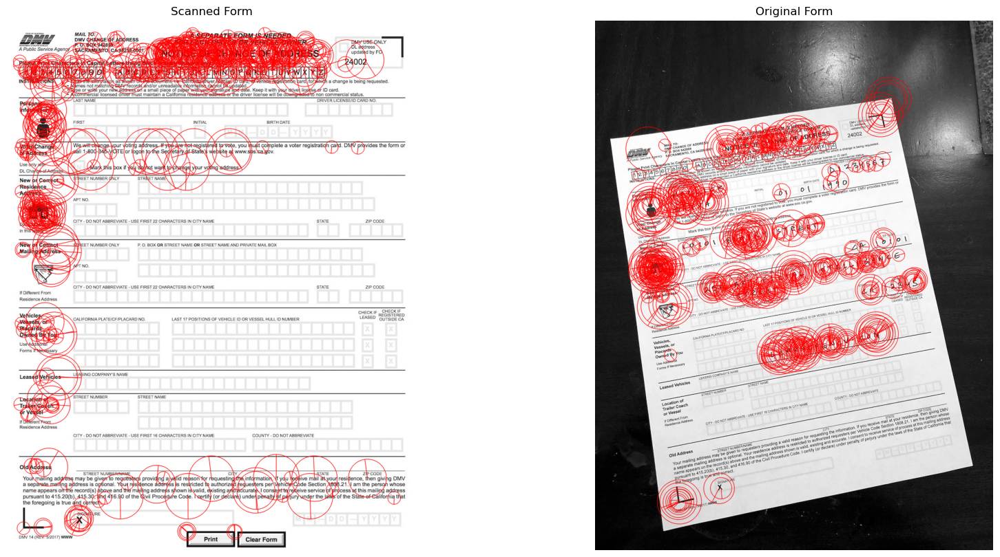

In [316]:
plt.figure(figsize=[20,10])
plt.subplot(121); plt.axis('off'); plt.imshow(im1_display); plt.title("Scanned Form");
plt.subplot(122); plt.axis('off'); plt.imshow(im2_display); plt.title("Original Form");

* The center of the circle is location of keypoint
* The size of cirle is scale of keypoint
* The radius line is orientation of the keypoint

### Match keypoints

In [318]:
matcher = cv2.DescriptorMatcher_create(cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING)
matches = list(matcher.match(descriptors1, descriptors2, None))

matches.sort(key=lambda x: x.distance, reverse=False)

# selecting the top matches
num_good_matches = int(len(matches)*0.1)
matches = matches[:num_good_matches]

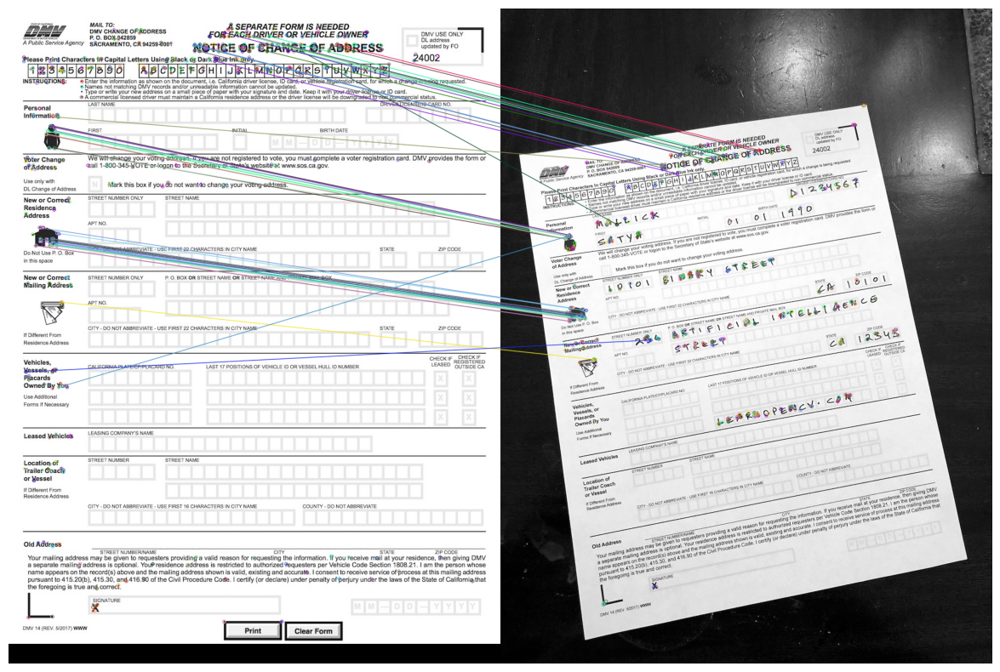

In [320]:
im_matches = cv2.drawMatches(img1_gray, keypoints1, img2_gray, keypoints2, matches, None)
plt.figure(figsize=[40,10])
plt.imshow(im_matches);
plt.axis("off");


In [332]:
points1 = np.zeros((len(matches), 2), dtype=np.float32)
points2 = np.zeros((len(matches), 2), dtype=np.float32)

for i, match in enumerate(matches):
    points1[i, :] = keypoints1[match.queryIdx].pt
    points2[i, :] = keypoints2[match.trainIdx].pt

homography, mask = cv2.findHomography(points2, points1, cv2.RANSAC)

Text(0.5, 1.0, 'Scanned Form')

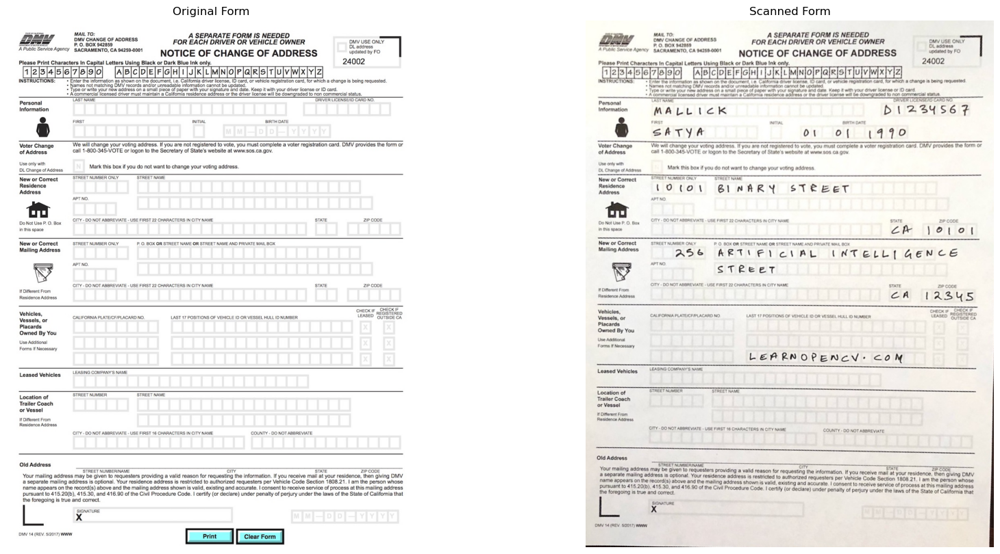

In [334]:
h, w, channels = form.shape
im2_reg = cv2.warpPerspective(scanned_form, homography, (w,h))

plt.figure(figsize=[20, 10])
plt.subplot(121);plt.imshow(form);    plt.axis("off");plt.title("Original Form")
plt.subplot(122);plt.imshow(im2_reg);plt.axis("off");plt.title("Scanned Form")

# Image Enhancement

In [ ]:
img = cv2.imread("img.jpeg", 1)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Adjust brightness

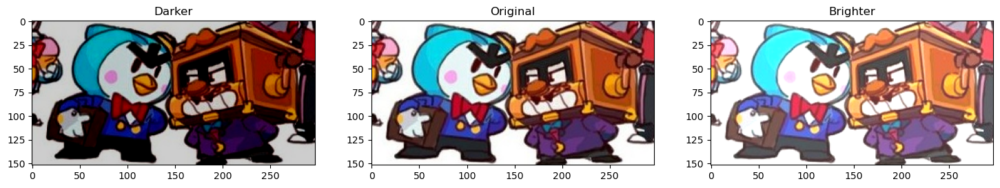

In [344]:
matrix = np.ones(img_rgb.shape, dtype='uint8')*50

img_rgb_brighter = cv2.add(img_rgb, matrix)
img_rgb_darker = cv2.subtract(img_rgb, matrix)

plt.figure(figsize=[18, 5])
plt.subplot(131); plt.imshow(img_rgb_darker);  plt.title("Darker");
plt.subplot(132); plt.imshow(img_rgb);         plt.title("Original");
plt.subplot(133); plt.imshow(img_rgb_brighter);plt.title("Brighter");

# Adjust contrast

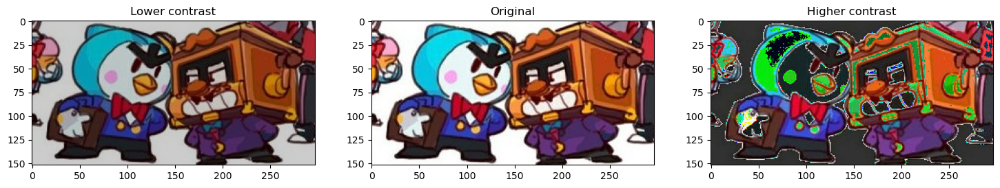

In [349]:
matrix1 = np.ones(img_rgb.shape, dtype='uint8') * .8
matrix2 = np.ones(img_rgb.shape, dtype='uint8') * 1.2

img_rgb_darker = np.uint8(cv2.multiply(np.float64(img_rgb), matrix1))
img_rgb_brighter = np.uint8(cv2.multiply(np.float64(img_rgb), matrix2))

plt.figure(figsize=[18, 5])
plt.subplot(131); plt.imshow(img_rgb_darker);  plt.title("Lower contrast");
plt.subplot(132); plt.imshow(img_rgb);         plt.title("Original");
plt.subplot(133); plt.imshow(img_rgb_brighter);plt.title("Higher contrast");

* The reason why higher contrast his disorted is because, when we multiply, we get values greater than 256
* Those white portions of the image were already 255, multiplying them made them bigger and when we convert to unsigned int - 8 bits is not enough to store that data, and leading parts roll over, which cause only partial info fitting in the bits, which is the reason for the distortion
* To handle overflow, we have to clip those values

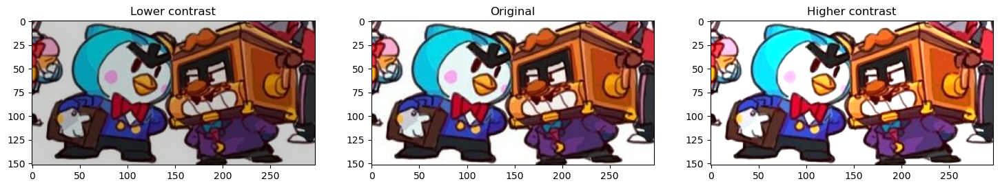

In [355]:
img_rgb_brighter = np.uint8(np.clip(cv2.multiply(np.float64(img_rgb), matrix2), 0, 255))
plt.figure(figsize=[18, 5])
plt.subplot(131); plt.imshow(img_rgb_darker);  plt.title("Lower contrast");
plt.subplot(132); plt.imshow(img_rgb);         plt.title("Original");
plt.subplot(133); plt.imshow(img_rgb_brighter);plt.title("Higher contrast");

# Image thresholding

* Lets us to create binary images which allows us to selectively modify portions of image while leaving other portions intact

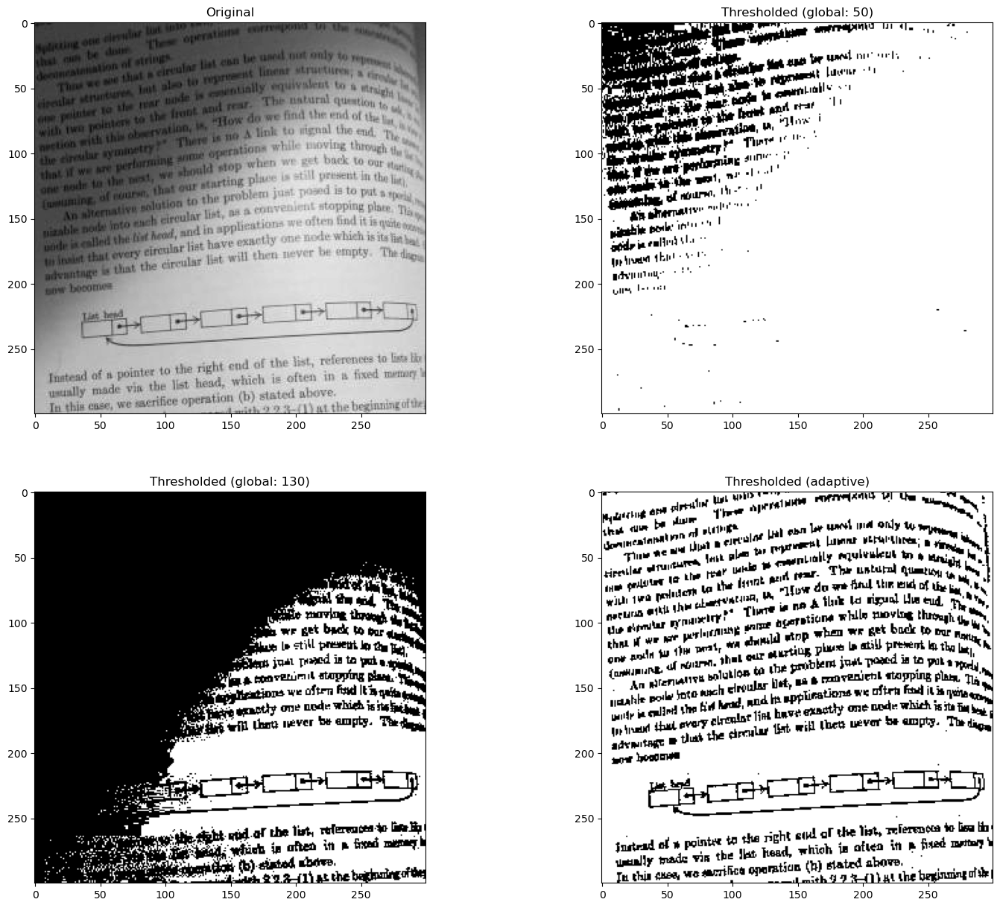

In [365]:
img_read = cv2.imread("page.jpg", cv2.IMREAD_GRAYSCALE)

retval, img_thresh_gbl_1 = cv2.threshold(img_read, 50, 255, cv2.THRESH_BINARY)
retval, img_thresh_gbl_2 = cv2.threshold(img_read, 130, 255, cv2.THRESH_BINARY)
img_thresh_adp = cv2.adaptiveThreshold(img_read, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 7)


plt.figure(figsize=[18,15])
plt.subplot(221); plt.imshow(img_read,        cmap="gray");  plt.title("Original");
plt.subplot(222); plt.imshow(img_thresh_gbl_1,cmap="gray");  plt.title("Thresholded (global: 50)");
plt.subplot(223); plt.imshow(img_thresh_gbl_2,cmap="gray");  plt.title("Thresholded (global: 130)");
plt.subplot(224); plt.imshow(img_thresh_adp,  cmap="gray");  plt.title("Thresholded (adaptive)");

# Bitwise operations

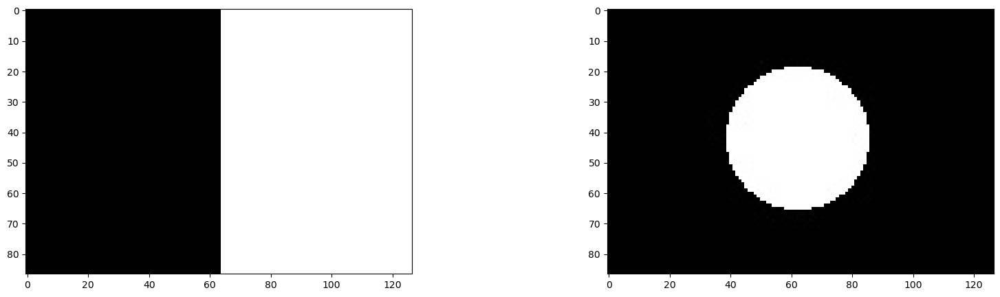

In [370]:
img_rec = cv2.imread("rect.jpg", cv2.IMREAD_GRAYSCALE)

img_cir = cv2.imread("circle.jpg", cv2.IMREAD_GRAYSCALE)

plt.figure(figsize=[20, 5])
plt.subplot(121);plt.imshow(img_rec, cmap="gray")
plt.subplot(122);plt.imshow(img_cir, cmap="gray")

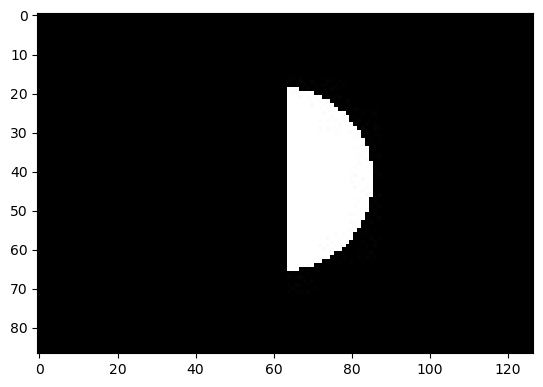

In [374]:
plt.imshow(cv2.bitwise_and(img_rec, img_cir, mask=None), cmap="gray")

* if both pixels are white, it returns white, else black 

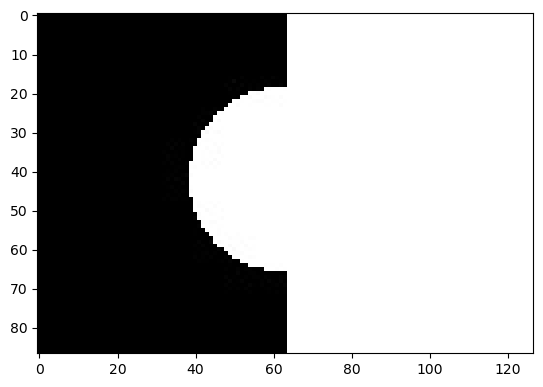

In [377]:
plt.imshow(cv2.bitwise_or(img_rec, img_cir, mask=None), cmap="gray")

* if both pixels are black, it returns black, else white

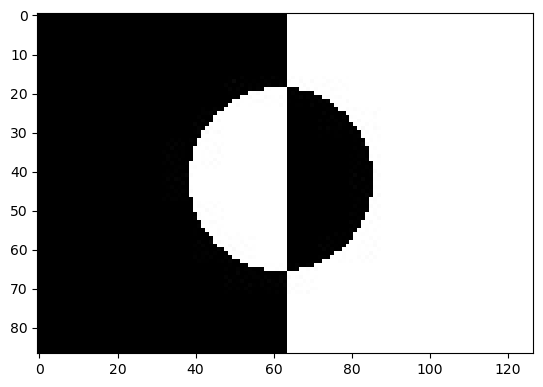

In [381]:
plt.imshow(cv2.bitwise_xor(img_rec, img_cir, mask=None), cmap="gray")

* if both pixels are different, it returns white, else black

In [9]:
img_bgr = cv2.imread("img.jpeg")
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
print(img_rgb.shape)

(152, 297, 3)


(152, 297, 3)


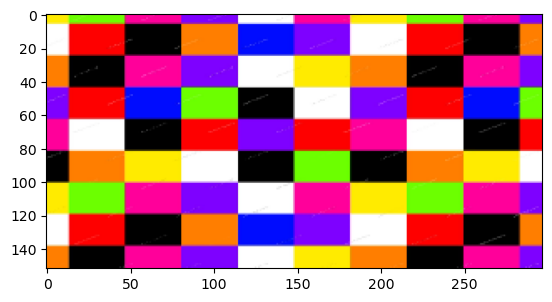

In [398]:
background_bgr = cv2.imread("colors.jpg")
background_rgb = cv2.cvtColor(background_bgr, cv2.COLOR_BGR2RGB)
background_rgb = cv2.resize(background_rgb, (297, 152))
print(background_rgb.shape)
plt.imshow(background_rgb);

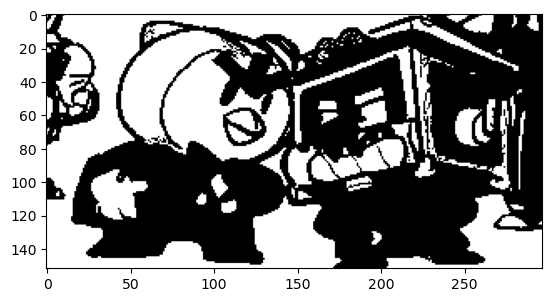

In [402]:
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
retval, img_mask = cv2.threshold(img_gray, 127, 255, cv2.THRESH_BINARY)
plt.imshow(img_mask, cmap="gray");

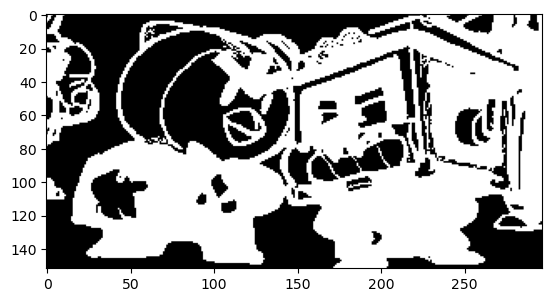

In [406]:
img_mask_inv = cv2.bitwise_not(img_mask)
plt.imshow(img_mask_inv, cmap="gray");

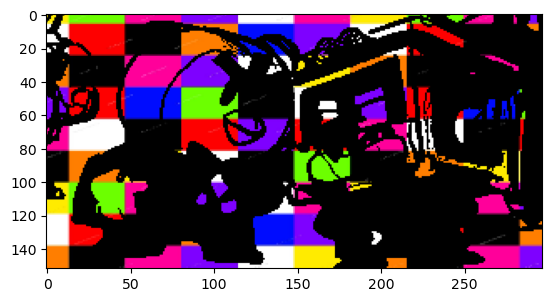

In [408]:
img_background = cv2.bitwise_and(background_rgb, background_rgb, mask=img_mask)
plt.imshow(img_background);

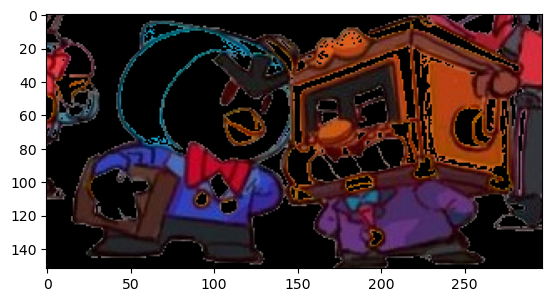

In [410]:
img_foreground = cv2.bitwise_and(img_rgb, img_rgb, mask=img_mask_inv)
plt.imshow(img_foreground);

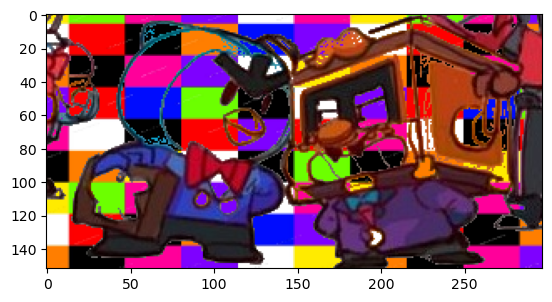

In [412]:
result = cv2.add(img_background, img_foreground)
plt.imshow(result)

# Panorama

In [417]:
import cv2
import glob
import os
import matplotlib.pyplot as plt
import math

imagefiles = glob.glob(f"boat{os.sep}*")
imagefiles.sort()


images = []
for filename in imagefiles:
    img = cv2.imread(filename)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    images.append(img)

num_images = len(images)

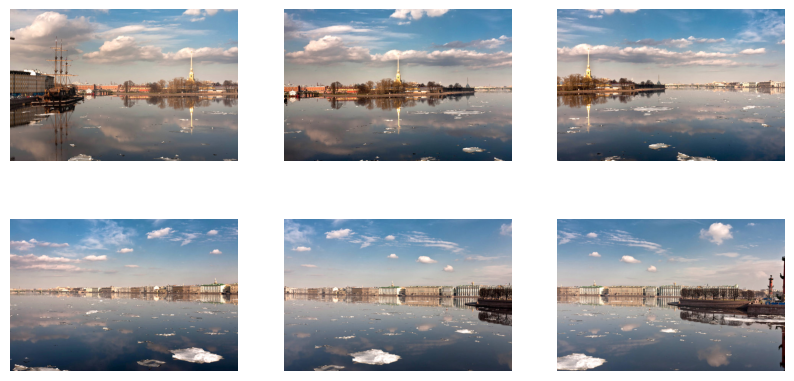

In [433]:
plt.figure(figsize=[10, 5])
num_cols = 3
num_rows = math.ceil(num_images / num_cols)
for i in range(0, num_images):
    plt.subplot(num_rows, num_cols, i + 1)
    plt.axis("off")
    plt.imshow(images[i])

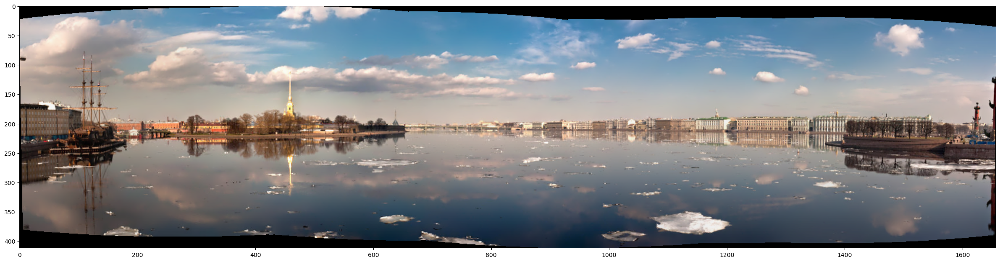

In [435]:
stitcher = cv2.Stitcher_create()
status, result = stitcher.stitch(images)

if status == 0:
    plt.figure(figsize=[30, 10])
    plt.imshow(result)

# High Dynamic Range Imaging (HDR`)

Assume a picture of a boy standing in green fields. In a regular photo one of the below two is seen:
* The foreground is clear, while the background is too bright/white
* The background is clear, while the foreground is too dark/dim

The reason that occurs is, the actual intensities in a real world scene far exceeds the capability of the cameras which record those values.<br>
Most of the cameras only have 8bit capacity for a channel, they dont have the capability to capture the full dynamic range of the scene

HDR mode solves this problem, but how?<br>
* It takes 3 (low dynamic range) photos of different exposures at once (almost instantly)
* And merges them to come up with the HDR

In [439]:
filenames = ["img_0.033.jpg", "img_0.25.jpg", "img_2.5.jpg", "img_15.jpg"]
times = np.array([1 / 30.0, 0.25, 2.5, 15.0], dtype=np.float32)

images = []
for filename in filenames:
    im = cv2.imread(filename)
    images.append(im)

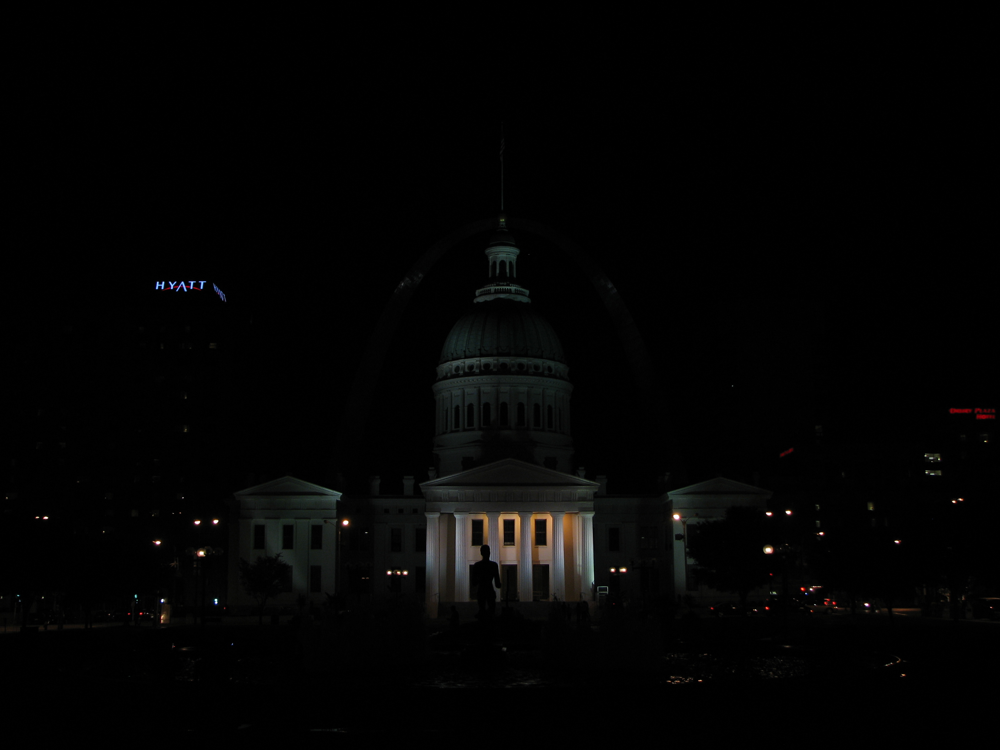

In [448]:
Image(filename= filenames[0])

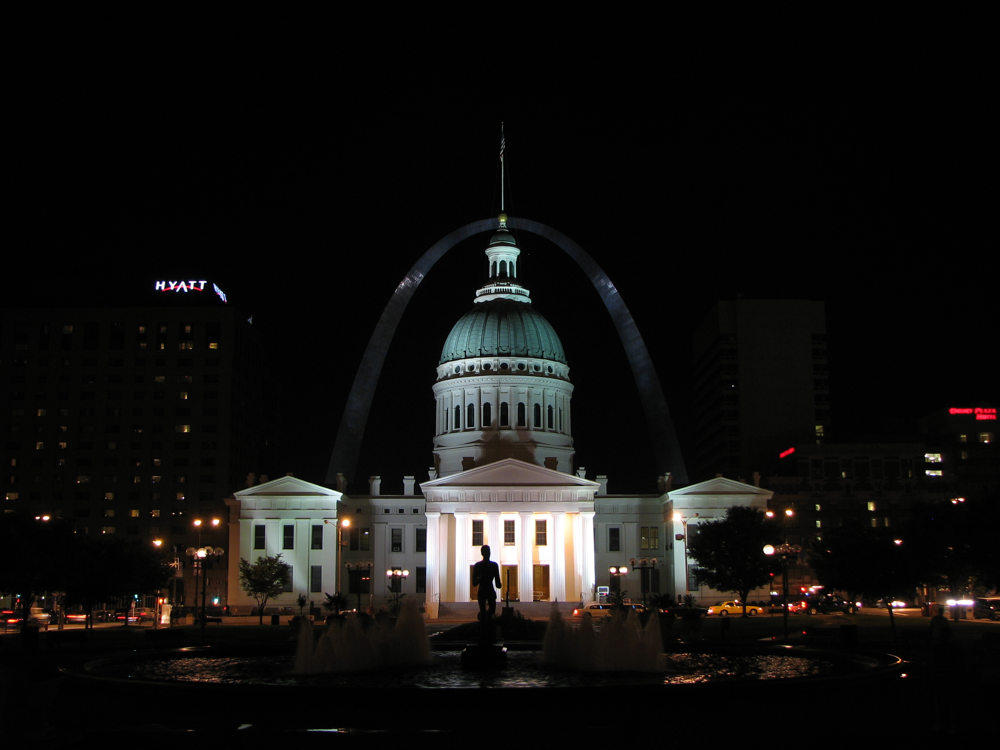

In [450]:
Image(filename= filenames[1])

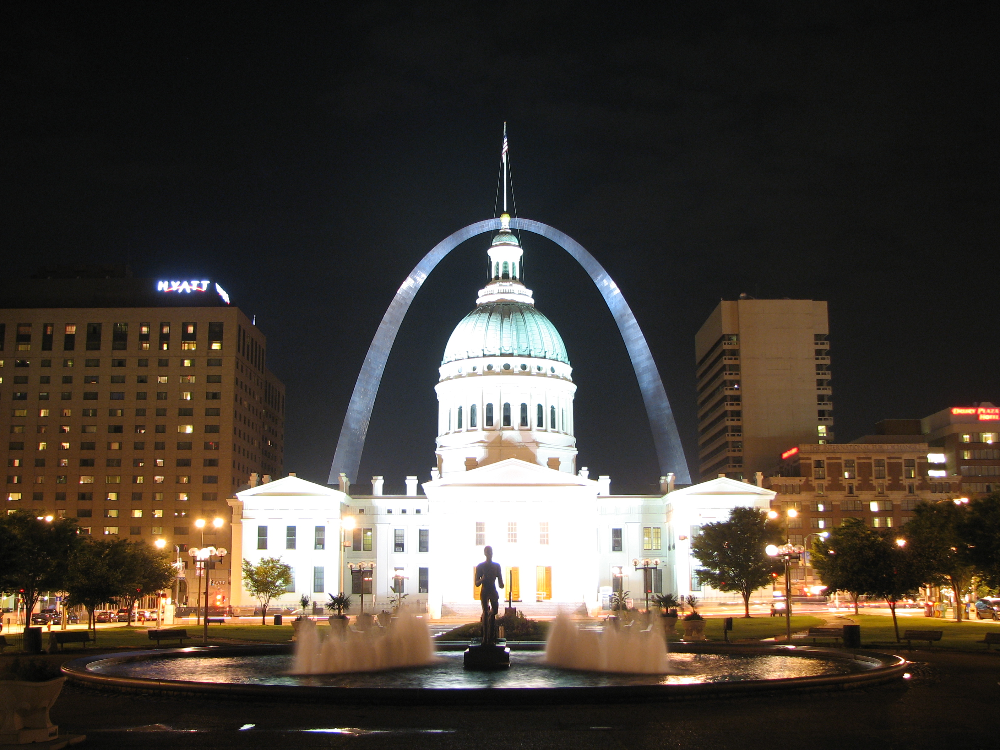

In [452]:
Image(filename= filenames[2])

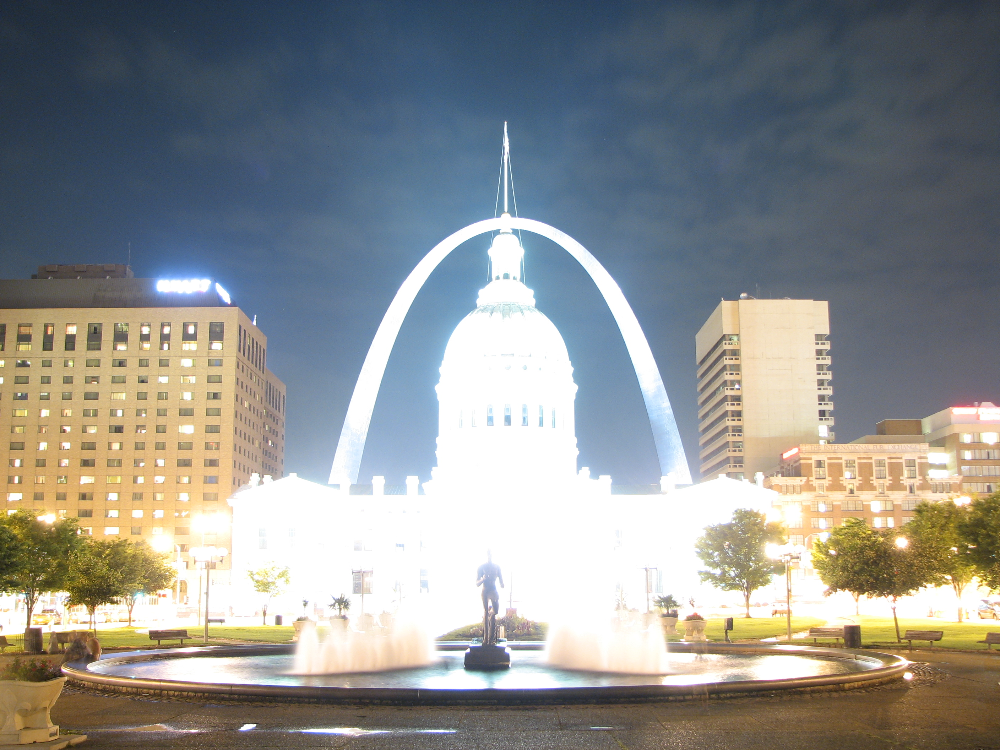

In [454]:
Image(filename= filenames[3])

We have to align the images down to the pixel level

In [442]:
alignMTB = cv2.createAlignMTB()
alignMTB.process(images, images)

Estimate camera response function<br>
The reason we do this is, most cameras we use are not linear, which means if the radiance of a scene gets doubled, the pixel intensity doesnt exactly get doubled

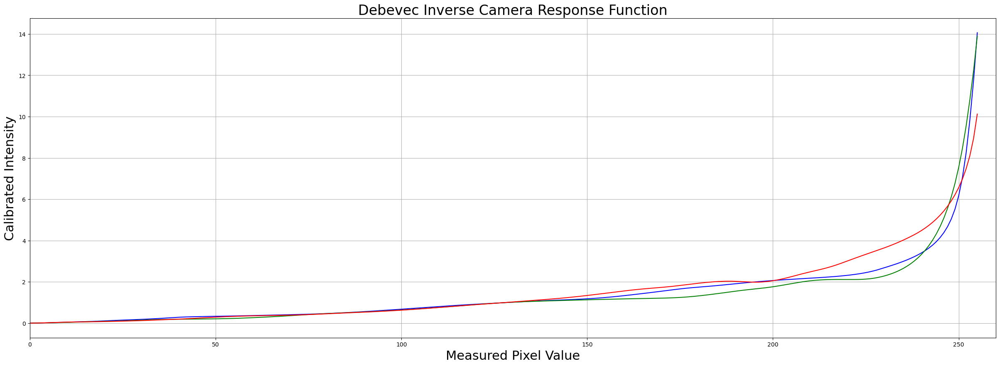

In [446]:
calibrateDebevec = cv2.createCalibrateDebevec()
responseDebevec = calibrateDebevec.process(images, times)

x = np.arange(256, dtype=np.uint8)
y = np.squeeze(responseDebevec)

ax = plt.figure(figsize=(30, 10))
plt.title("Debevec Inverse Camera Response Function", fontsize=24)
plt.xlabel("Measured Pixel Value", fontsize=22)
plt.ylabel("Calibrated Intensity", fontsize=22)
plt.xlim([0, 260])
plt.grid()
plt.plot(x, y[:, 0], "b", x, y[:, 1], "g", x, y[:, 2], "r")

Merge Exposure into an HDR image

In [457]:
mergeDebevec = cv2.createMergeDebevec()
hdrDebevac = mergeDebevec.process(images, times, responseDebevec)

Tonemapping
* converts HDR to 8bit per channel
* Since we are combining images from different exposure, the pixel values range for the same color vary across the images, we have to bring them all to the same range

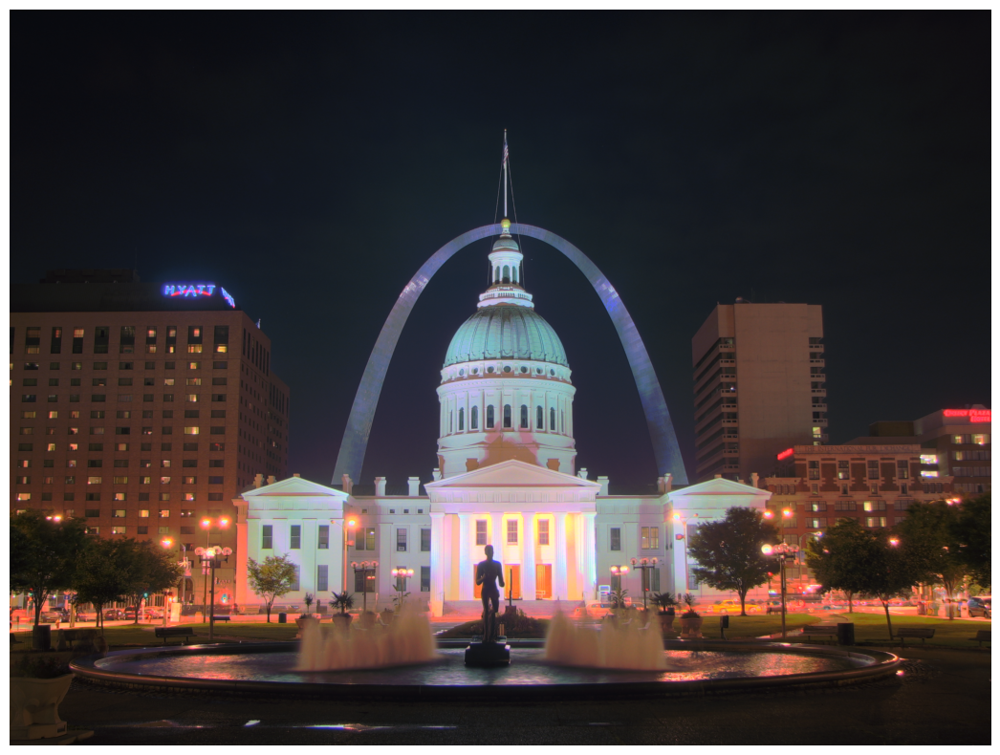

In [463]:
tonemapDrago = cv2.createTonemapDrago(1.0, 0.7)
ldrDrago = tonemapDrago.process(hdrDebevac)
ldrDrago = 3*ldrDrago
plt.figure(figsize=(20, 10));plt.imshow(np.clip(ldrDrago, 0, 1)[:,:,::-1]);plt.axis("off");